# Bonjour et bienvenue à notre projet : attaque adversaire en segmentation, effectué par Yassine Zanned, Seifeddine Ghozzi et Ameni Hidouri

Ce projet porte sur la conception et l’analyse d’attaques adversariales appliquées à des modèles de segmentation d’images. Une attaque adversariale consisteà introduire de légères perturbations dans une image, souvent invisibles pour unobservateur humain, afin de tromper un modèle d’apprentissage automatique.L’objectif principal est de comprendre la vulnérabilité des modèles de segmenta-tion et d’évaluer leur robustesse dans différents scénarios adversariaux.

### Objectifs du Projet

Les objectifs principaux sont les suivants :

- *Q1 :* Développer une attaque non ciblée (untargeted) qui pousse un modèle à produire des erreurs dans ses prédictions.
- *Q2 :* Concevoir une attaque ciblée (targeted) pour forcer le modèle à prédire une segmentation spécifique.
- *Q3 :* Étudier l’impact de la taille des perturbations sur la performance de l’attaque.
- *Q4 :* Évaluer la robustesse d’une attaque lorsqu’elle est appliquée à un modèle différent de celui utilisé pour la concevoir.
- *Q5 :* Explorer l’effet d’entraîner une attaque sur un ensemble de réseaux plutôt que sur un seul.

---

### Méthodologie

#### Données utilisées

- *Dataset MS-COCO :* Un sous-ensemble de 50 images a été extrait. Ces images incluent plusieurs objets segmentables et sont riches en contextes variés.

#### Modèles de segmentation

Des modèles de segmentation préentraînés fournis par *Torchvision* ont été utilisés :

- *DeepLabV3 (ResNet50)*
- *Mask R-CNN*
- *DeiT*

#### Attaques implémentées

##### Attaque Non Ciblée (Untargeted)

Cette attaque perturbe les prédictions sans viser une sortie spécifique. Nous avons utilisé la méthode *Fast Gradient Sign Method (FGSM)*.

##### Attaque Ciblée (Targeted)

Ici, l’objectif est de forcer le modèle à produire des résultats correspondant à une classe cible. La méthode *Projected Gradient Descent (PGD)* a été employée, avec une contrainte sur la classe cible.

#### Évaluation des attaques

- *Q3 :* Étude de la performance en mesurant des métriques telles que l’IoU (Intersection over Union) et le coefficient Dice.
- *Q4 :* Tester la généralisabilité de l’attaque sur un autre modèle de segmentation.
- *Q5 :* Entraîner l’attaque sur plusieurs réseaux pour observer une amélioration de sa robustesse.

Pour évaluer les performances du modèle après l'application de l'attaque (comme demandé dans Q3), nous allons mesurer la performance de segmentation sur les images originales et adversariales. Une métrique couramment utilisée pour évaluer la segmentation est l'IoU (Intersection over Union).

---

Nous allons tenter de répondre aux questions au fur et à mesure qu'on avance dans le notebook.

## Importation d'images de MS-COCO

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models.segmentation as models
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


# Création du dossier coco pour stocker les images

In [2]:
!mkdir coco

# Télécharger les images de validation (val 2017)
!wget https://httpmail.onera.fr/21/050a4e5c4611d260c1b8035b5dc8617eO1A12h/coco_sample.pth -P coco

--2025-01-30 21:12:18--  https://httpmail.onera.fr/21/050a4e5c4611d260c1b8035b5dc8617eO1A12h/coco_sample.pth
Resolving httpmail.onera.fr (httpmail.onera.fr)... 144.204.16.9
Connecting to httpmail.onera.fr (httpmail.onera.fr)|144.204.16.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 29204400 (28M) [application/force-download]
Saving to: ‘coco/coco_sample.pth’

coco_sample.pth     100%[===================>]  27.85M  12.1MB/s    in 2.3s    

2025-01-30 21:12:21 (12.1 MB/s) - ‘coco/coco_sample.pth’ saved [29204400/29204400]



# Charger le fichier coco_sample.pth

In [3]:
import torch

data = torch.load("/content/coco/coco_sample.pth")  # Load the file

<class 'torch.Tensor'>
torch.Size([9, 3, 520, 520])


<ipython-input-3-ab29cbf168b9>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data = torch.load("/content/coco/coco_sample.pth")  # Load the file


# Extraire les images du fichier

In [4]:
import torchvision.transforms as transforms
from PIL import Image
import os

# Create output directory
output_dir = "extracted_images"
os.makedirs(output_dir, exist_ok=True)

# Convert tensor to PIL Image
to_pil = transforms.ToPILImage()

# Extract images
num_images = data.shape[0]  # Assuming shape is [N, C, H, W]
for i in range(num_images):
    img_tensor = data[i]  # Get i-th image tensor
    img = to_pil(img_tensor)  # Convert to PIL image
    img.save(os.path.join(output_dir, f"image_{i}.png"))

print(f"Extracted {num_images} images to {output_dir}/")


Extracted 9 images to extracted_images/


# Afficher les 9 images chargées

/content/extracted_images/image_5.png


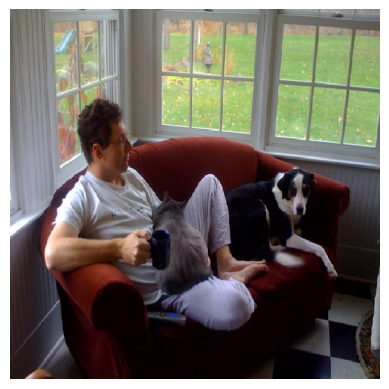

/content/extracted_images/image_4.png


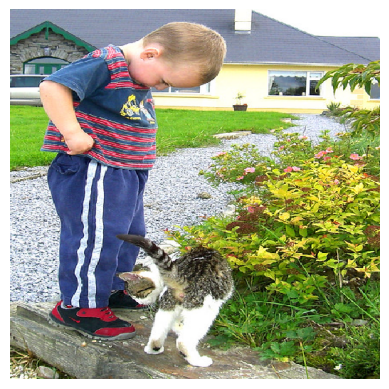

/content/extracted_images/image_0.png


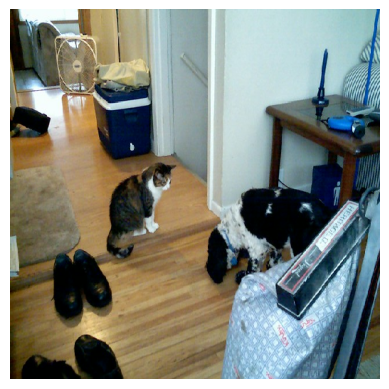

/content/extracted_images/image_7.png


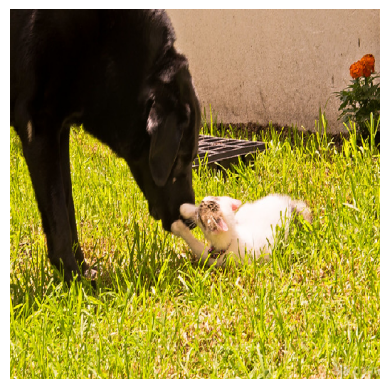

/content/extracted_images/image_6.png


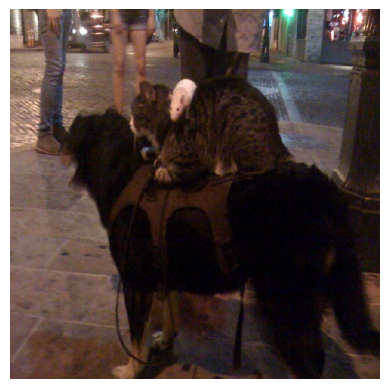

/content/extracted_images/image_2.png


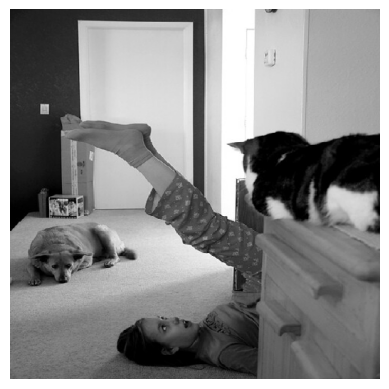

/content/extracted_images/image_8.png


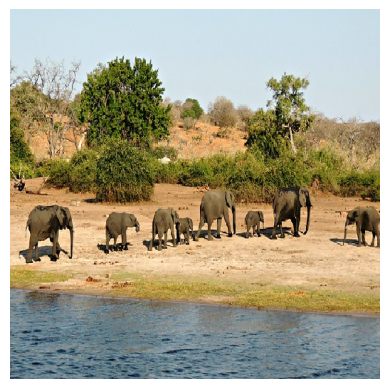

/content/extracted_images/image_3.png


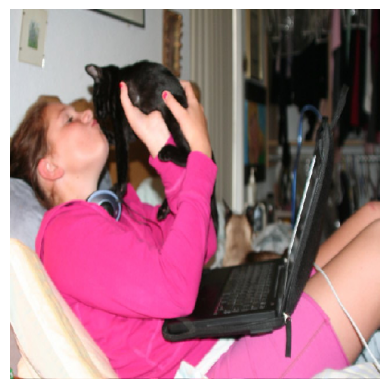

/content/extracted_images/image_1.png


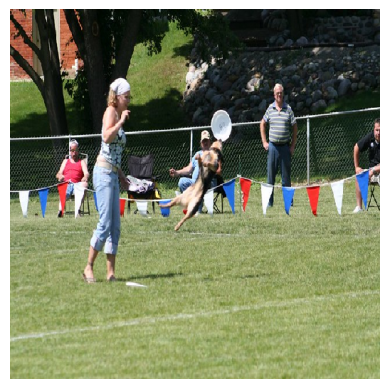

In [5]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# Définir le chemin vers les images
coco_path = '/content/extracted_images'

# Lister les fichiers d'images
images = os.listdir(coco_path)

# Sélectionner des images au hasard
num = 9
selected_images = random.sample(images, num)

# Afficher quelques-unes des images (par exemple, 5)
for i in range(num):
    img_path = os.path.join(coco_path, selected_images[i])
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    print(img_path)
    plt.show()

# Préparer le dispositif du travail (dans le cas où on aura besoin du GPU au lieu de CPU car certaines tâches sont coûteuses en matière de mémoire)

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Importer le 1er modèle Deeplabv3_resnet50

In [7]:
# Load DeepLabV3 with ResNet50 Backbone (Pretrained on COCO)
model = models.deeplabv3_resnet50(pretrained=True).to(device)
model.eval()  # Set model to evaluation mode


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/deeplabv3_resnet50_coco-cd0a2569.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet50_coco-cd0a2569.pth
100%|██████████| 161M/161M [00:01<00:00, 127MB/s]


DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Se

# Prétraitement des images

In [8]:
# Define image transformations
transform = transforms.Compose([
    transforms.Resize((520, 520)),  # Resize to match DeepLabV3 input
    transforms.ToTensor(),
])

# Select random images from the COCO dataset
coco_path = '/content/extracted_images'
# selected_image = selected_images[random.randrange(0, num)]

input_tensors = []

for selected_image in selected_images:
    img_path = os.path.join(coco_path, selected_image)

    # Load and preprocess each image image
    image = Image.open(img_path).convert("RGB")
    input_tensor = transform(image).unsqueeze(0).to(device)  # Add batch dimension

    input_tensors.append(input_tensor)

# Fonction pour faire l'attaque FGSM (Fast Gradient Sign Method):
L'idée est d’ajouter une petite perturbation adversariale à l’image d’entrée, de manière à maximiser la perte du modèle tout en gardant la perturbation imperceptible.

Calcul du gradient de la perte : On dérive la fonction de perte
𝐽
(
𝜃
,
𝑥
,
𝑦
)
J(θ,x,y) du modèle par rapport à l’entrée
𝑥
x, ce qui donne le gradient
∇
𝑥
𝐽
.

Ajout d’une perturbation dans la direction du gradient : On applique une petite modification proportionnelle au signe du gradient, avec une intensité contrôlée par un paramètre
𝜖
ϵ :
𝑥
′
=
𝑥
+
𝜖
⋅
sign
(
∇
𝑥
𝐽
)
x
′
 =x+ϵ⋅sign(∇
x
​
 J)

Obtenir une image perturbée : L’image résultante
𝑥
′
x
′
  est visuellement proche de l’originale mais peut induire des erreurs de classification ou de segmentation.

In [9]:
def fgsm_attack(image, epsilon, gradient):
    sign_data_grad = gradient.sign()  # Get sign of gradients
    perturbed_image = image + epsilon * sign_data_grad  # Add perturbation
    perturbed_image = torch.clamp(perturbed_image, 0, 1)  # Keep pixel values valid
    return perturbed_image


# Faire l'attaque en segmentation sur les 9 images

In [10]:
# Define loss function
criterion = nn.CrossEntropyLoss()
epsilon = 0.01  # Small perturbation value
adv_images = []
adv_outputs = []
adv_targets = []

for input_tensor in input_tensors:
    # Ensure gradients are enabled
    input_tensor.requires_grad = True

    # Forward pass
    output = model(input_tensor)["out"]
    target = torch.argmax(output, dim=1)  # Get predicted segmentation map

    # Compute loss
    loss = criterion(output, target)

    # Backpropagate to get gradients
    model.zero_grad()
    loss.backward()

    # Get the gradient of the input image
    gradient = input_tensor.grad.data

    # Generate adversarial image with FGSM
    adv_image = fgsm_attack(input_tensor, epsilon, gradient)
    adv_images.append(adv_image)

    # Run model on adversarial image
    adv_output = model(adv_image)["out"]
    adv_target = torch.argmax(adv_output, dim=1)
    adv_outputs.append(adv_output)
    adv_targets.append(adv_target)

# Afficher les images originales et attaquées sans segmentation
On n'observe pas une différences entre une image originale et attaquée: ce sont des perturbations imperceptibles à l'oeil nu.

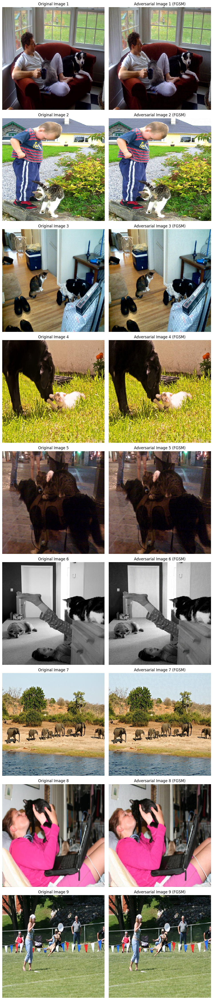

In [11]:
def show_images(originals, adversarials, num):
    fig, axs = plt.subplots(num, 2, figsize=(10, 5 * num))

    for i in range(num):
        # Convert tensors to images
        orig_img = transforms.ToPILImage()(originals[i].squeeze().cpu())
        adv_img = transforms.ToPILImage()(adversarials[i].squeeze().cpu())

        axs[i, 0].imshow(orig_img)
        axs[i, 0].set_title(f"Original Image {i+1}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(adv_img)
        axs[i, 1].set_title(f"Adversarial Image {i+1} (FGSM)")
        axs[i, 1].axis("off")

    plt.tight_layout()
    plt.show()

# Example usage
show_images(input_tensors, adv_images, num)

# Fonction pour calculer l'IoU:
L’IoU (Intersection over Union) est une métrique utilisée pour évaluer la précision des modèles de détection d’objets et de segmentation d’images. Elle mesure le chevauchement entre la prédiction et la vérité terrain (ground truth).

Formule de l’IoU :
𝐼
𝑜
𝑈
=
Aire de l’intersection
Aire de l’union
IoU=
Aire de l’union /
Aire de l’intersection
​

où :

Intersection : la région commune entre la boîte de prédiction et la boîte réelle.

Union : la somme des deux aires, en évitant de compter deux fois la zone d’intersection.
Interprétation des valeurs :
𝐼
𝑜
𝑈
=
1

IoU=1 : prédiction parfaite.
𝐼
𝑜
𝑈
=
0

IoU=0 : aucune superposition.
0.5
≤
𝐼
𝑜
𝑈
<
1
0.5≤IoU<1 : généralement considéré comme une bonne prédiction en détection d’objets (ex. seuil à 0.5 pour mAP).

In [12]:
import matplotlib.pyplot as plt
import torch

def compute_iou(pred, target):
    """
    Compute Intersection over Union (IoU) score.
    - pred: Model segmentation output (class labels, 2D tensor)
    - target: Ground truth labels (2D tensor)
    """
    intersection = torch.sum((pred == target) * (target > 0))  # Common pixels
    union = torch.sum((pred > 0)) + torch.sum((target > 0)) - intersection  # Total area
    iou = intersection / union if union != 0 else torch.tensor(0.0)  # Avoid division by zero
    return iou.cpu().item()

# Afficher les résultats de l'attaque FGSM en segmentation  

Image 1: IoU Before Attack: 1.0000, IoU After Attack: 0.2003, 🔻 IoU Drop: 0.7997
Image 2: IoU Before Attack: 1.0000, IoU After Attack: 0.4919, 🔻 IoU Drop: 0.5081
Image 3: IoU Before Attack: 1.0000, IoU After Attack: 0.0341, 🔻 IoU Drop: 0.9659
Image 4: IoU Before Attack: 1.0000, IoU After Attack: 0.1737, 🔻 IoU Drop: 0.8263
Image 5: IoU Before Attack: 1.0000, IoU After Attack: 0.0040, 🔻 IoU Drop: 0.9960
Image 6: IoU Before Attack: 1.0000, IoU After Attack: 0.2772, 🔻 IoU Drop: 0.7228
Image 7: IoU Before Attack: 0.0000, IoU After Attack: 0.0000, 🔻 IoU Drop: 0.0000
Image 8: IoU Before Attack: 1.0000, IoU After Attack: 0.0015, 🔻 IoU Drop: 0.9985
Image 9: IoU Before Attack: 1.0000, IoU After Attack: 0.2617, 🔻 IoU Drop: 0.7383


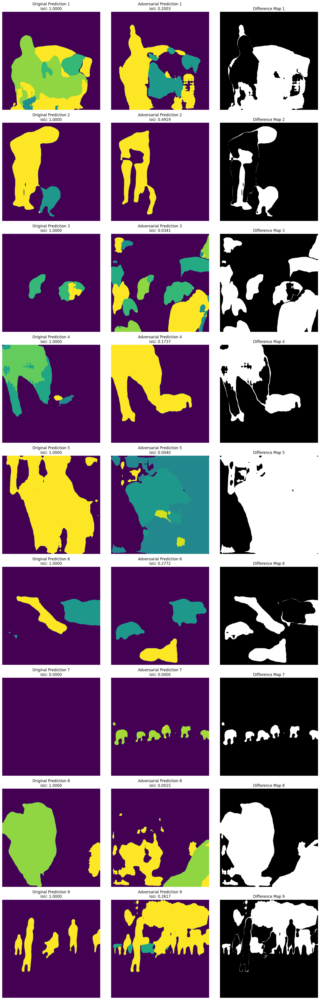

In [13]:
import gc

original_preds = []
def show_adversarial_results(input_tensors, adv_images, adv_outputs, adv_targets, num):
    fig, axs = plt.subplots(num, 3, figsize=(15, 5 * num))

    for i in range(num):
        input_tensor = input_tensors[i].to("cuda")  # Move single image to GPU
        adv_image = adv_images[i].to("cuda")

        # Process one image at a time to avoid memory overload
        with torch.no_grad():
            original_output = model(input_tensor)["out"]
        original_pred = torch.argmax(original_output, dim=1).cpu()  # Move result to CPU

        adv_output = model(adv_image)["out"]
        adv_pred = torch.argmax(adv_output, dim=1).cpu()  # Move result to CPU

        # Compute IoU
        iou_before = compute_iou(original_pred, original_pred)
        iou_after = compute_iou(adv_pred, original_pred)

        # Row-wise plotting
        axs[i, 0].imshow(original_pred[0].numpy(), cmap="viridis")
        axs[i, 0].set_title(f"Original Prediction {i+1}\nIoU: {iou_before:.4f}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(adv_pred[0].numpy(), cmap="viridis")
        axs[i, 1].set_title(f"Adversarial Prediction {i+1}\nIoU: {iou_after:.4f}")
        axs[i, 1].axis("off")

        axs[i, 2].imshow((original_pred[0] != adv_pred[0]).numpy(), cmap="gray")
        axs[i, 2].set_title(f"Difference Map {i+1}")
        axs[i, 2].axis("off")

        print(f"Image {i+1}: IoU Before Attack: {iou_before:.4f}, IoU After Attack: {iou_after:.4f}, 🔻 IoU Drop: {iou_before - iou_after:.4f}")

        # Free memory after processing each image
        del input_tensor, adv_image, original_output, adv_output
        torch.cuda.empty_cache()
        gc.collect()

    plt.tight_layout()
    plt.show()

show_adversarial_results(input_tensors, adv_images, adv_outputs, adv_targets, num)

# Mesure d'IoU pour différentes valeurs d'epsilon (FGSM)
--> On conclut que lorsque epsilon augmente (plus de perturbations), l'attaque est plus efficace (intense) et l'IoU diminue

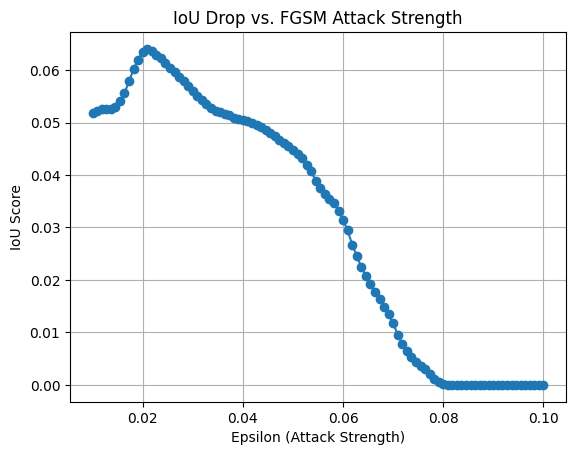

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt

epsilons = list(np.linspace(0.01, 0.1, 100))  # Different perturbation strengths
iou_scores = []

for eps in epsilons:
    adv_images = []
    adv_targets = []

    for input_tensor in input_tensors:
        input_tensor.requires_grad = True
        output = model(input_tensor)["out"]
        target = torch.argmax(output, dim=1)  # Get model prediction

        loss = criterion(output, target)
        model.zero_grad()
        loss.backward()
        gradient = input_tensor.grad.data

        # FGSM Attack
        adv_image = fgsm_attack(input_tensor, eps, gradient)
        adv_output = model(adv_image)["out"]
        adv_target = torch.argmax(adv_output, dim=1)

        adv_images.append(adv_image)
        adv_targets.append(adv_target)

    # Compute IoU
    iou = compute_iou(adv_targets[0], target)
    iou_scores.append(iou)

# **Plot IoU drop vs. epsilon**
plt.plot(epsilons, iou_scores, marker="o", linestyle="-")
plt.xlabel("Epsilon (Attack Strength)")
plt.ylabel("IoU Score")
plt.title("IoU Drop vs. FGSM Attack Strength")
plt.grid(True)
plt.show()


# Influence des hyperparamètres du PGD (algorithme expliqué ci-dessous) (alpha, num of steps, epsilon) sur l'évolution de l'IoU:
num_steps : Nombre d’itérations de l’attaque PGD.

alpha : Taille du pas (amplitude du changement de l’image à chaque itération).

epsilon : Perturbation totale maximale autorisée.

Si on augmente num_steps (plus d’itérations) → Réduction de l’IoU (attaque plus forte).

Si on augmente alpha (pas plus grand) → Cela peut déstabiliser l’attaque (un pas trop grand peut dépasser l’objectif).

Si on augmente epsilon (perturbation maximale plus élevée) → Plus de mauvaises classifications, IoU plus faible.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Steps: 5, Alpha: 0.005, Epsilon: 0.03, IoU: 0.5806
Steps: 5, Alpha: 0.005, Epsilon: 0.06, IoU: 0.5803
Steps: 5, Alpha: 0.005, Epsilon: 0.1, IoU: 0.5795
Steps: 5, Alpha: 0.01, Epsilon: 0.03, IoU: 0.6725
Steps: 5, Alpha: 0.01, Epsilon: 0.06, IoU: 0.6658
Steps: 5, Alpha: 0.01, Epsilon: 0.1, IoU: 0.6662
Steps: 5, Alpha: 0.02, Epsilon: 0.03, IoU: 0.6756
Steps: 5, Alpha: 0.02, Epsilon: 0.06, IoU: 0.6652
Steps: 5, Alpha: 0.02, Epsilon: 0.1, IoU: 0.6616
Steps: 10, Alpha: 0.005, Epsilon: 0.03, IoU: 0.5742
Steps: 10, Alpha: 0.005, Epsilon: 0.06, IoU: 0.5698
Steps: 10, Alpha: 0.005, Epsilon: 0.1, IoU: 0.5667
Steps: 10, Alpha: 0.01, Epsilon: 0.03, IoU: 0.5882
Steps: 10, Alpha: 0.01, Epsilon: 0.06, IoU: 0.5546
Steps: 10, Alpha: 0.01, Epsilon: 0.1, IoU: 0.5556
Steps: 10, Alpha: 0.02, Epsilon: 0.03, IoU: 0.6718
Steps: 10, Alpha: 0.02, Epsilon: 0.06, IoU: 0.6386
Steps: 10, Alpha: 0.02, Epsilon: 0.1, IoU: 0.5854
Steps: 20, Alpha: 0.005, Epsilon: 0.03, IoU: 0.5725
Steps: 20, Alpha: 0.005, Epsilon: 0.06,

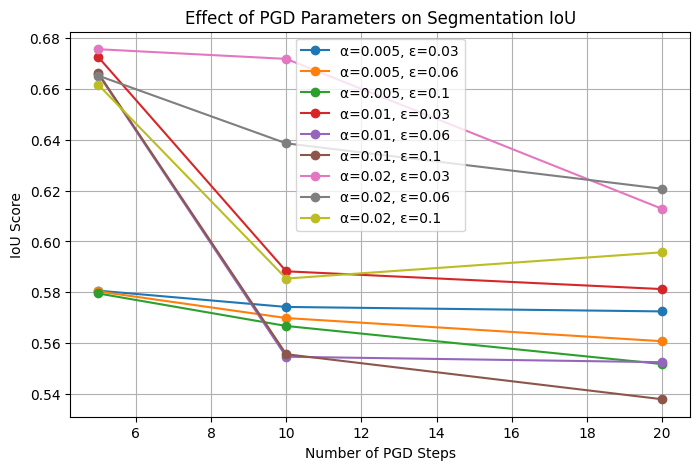

In [16]:
# Load the pre-trained DeepLabV3 model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = models.deeplabv3_resnet50(pretrained=True).to(device)
model.eval()

# Define preprocessing
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

transform = transforms.Compose([
    transforms.Resize((512, 512)),  # Resize image
    transforms.ToTensor(),          # Convert to tensor
    transforms.Normalize(mean=mean, std=std)  # Normalize
])

# Load an image
img_path = "/content/extracted_images/image_4.png"
image = Image.open(img_path).convert("RGB")
input_img = transform(image).unsqueeze(0).to(device)  # Add batch dimension

# Get original segmentation
with torch.no_grad():
    orig_output = model(input_img)["out"]
    orig_pred = torch.argmax(orig_output, dim=1).cpu().squeeze(0).numpy()

# Define IoU function
def compute_iou(mask1, mask2):
    """Computes the Intersection over Union (IoU) between two masks."""
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    return intersection / union if union != 0 else 0

# Define PGD parameters for testing
step_values = [5, 10, 20]  # Number of PGD iterations
alpha_values = [0.005, 0.01, 0.02]  # Step sizes
epsilon_values = [0.03, 0.06, 0.1]  # Maximum perturbations

results = []  # Store IoU results

# Loop over different PGD parameters
for num_steps in step_values:
    for alpha in alpha_values:
        for epsilon in epsilon_values:
            # Create adversarial image
            adv_img = input_img.clone().detach().requires_grad_(True)
            criterion = nn.CrossEntropyLoss()

            # Target label (force output to predict "cat" everywhere)
            target_class = 8  # Example: Targeting the "cat" class (COCO class index for cat)
            target_label = torch.full((1, 512, 512), target_class, dtype=torch.long).to(device)

            # PGD attack loop
            for i in range(num_steps):
                model.zero_grad()
                output = model(adv_img)["out"]
                loss = -criterion(output, target_label)  # Targeted attack
                loss.backward()

                # Apply perturbation
                adv_img.data = adv_img.data - alpha * adv_img.grad.data.sign()

                # Project perturbation to epsilon-ball
                perturbation = torch.clamp(adv_img - input_img, -epsilon, epsilon)
                adv_img.data = torch.clamp(input_img + perturbation, 0, 1)

                # Reset gradients
                adv_img.grad.zero_()

            # Get adversarial segmentation
            with torch.no_grad():
                adv_output = model(adv_img)["out"]
                adv_pred = torch.argmax(adv_output, dim=1).cpu().squeeze(0).numpy()

            # Compute IoU
            iou_score = compute_iou(orig_pred, adv_pred)
            results.append((num_steps, alpha, epsilon, iou_score))
            print(f"Steps: {num_steps}, Alpha: {alpha}, Epsilon: {epsilon}, IoU: {iou_score:.4f}")

# Convert results to a structured format for analysis
import pandas as pd
df = pd.DataFrame(results, columns=["Steps", "Alpha", "Epsilon", "IoU"])

# Plot IoU values
fig, ax = plt.subplots(figsize=(8, 5))
for alpha in alpha_values:
    subset = df[df["Alpha"] == alpha]
    for epsilon in epsilon_values:
        eps_subset = subset[subset["Epsilon"] == epsilon]
        ax.plot(eps_subset["Steps"], eps_subset["IoU"], marker="o", label=f"α={alpha}, ε={epsilon}")

ax.set_xlabel("Number of PGD Steps")
ax.set_ylabel("IoU Score")
ax.set_title("Effect of PGD Parameters on Segmentation IoU")
ax.legend()
plt.grid()
plt.show()

# PGD (Projected Gradient Descent):
L'attaque PGD (Projected Gradient Descent) est une méthode d’attaque adversariale itérative qui cherche à tromper un modèle de deep learning en modifiant légèrement une image d’entrée.

# Faire une attaque non ciblée sur les photos (Untargeted PGD):
C'est une méthode d'attaque adversariale itérative qui cherche à maximiser la perte du modèle en perturbant l'image d'entrée dans le but de le tromper. Contrairement à une attaque ciblée qui force le modèle à prédire une classe spécifique, l'attaque non ciblée vise simplement à faire en sorte que la prédiction soit incorrecte, sans contrainte sur la classe finale.

Image 1: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.9440, 🔻 IoU Drop: 0.0560
Image 2: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.1123, 🔻 IoU Drop: 0.8877
Image 3: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.0638, 🔻 IoU Drop: 0.9362
Image 4: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.2453, 🔻 IoU Drop: 0.7547
Image 5: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.5531, 🔻 IoU Drop: 0.4469
Image 6: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.0661, 🔻 IoU Drop: 0.9339
Image 7: IoU Before Attack: 0.0000, IoU After PGD Attack: 0.0000, 🔻 IoU Drop: 0.0000
Image 8: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.3608, 🔻 IoU Drop: 0.6392
Image 9: IoU Before Attack: 1.0000, IoU After PGD Attack: 0.0956, 🔻 IoU Drop: 0.9044


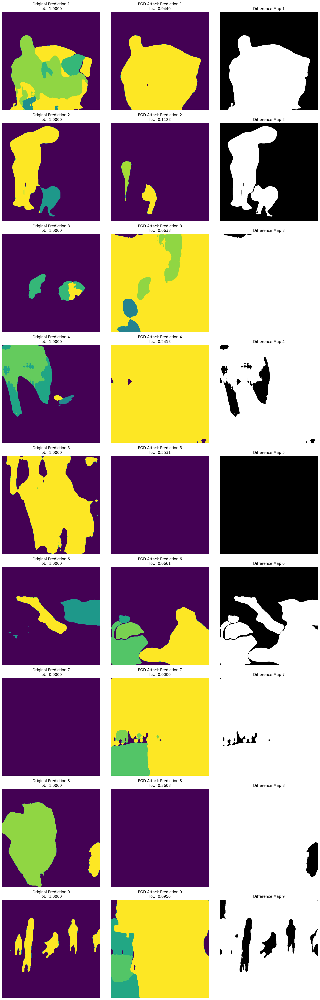

In [17]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt

def pgd_attack(model, image, target, epsilon=0.02, alpha=0.005, iterations=10):
    adv_image = image.clone().detach()
    adv_image.requires_grad = True  # Enable gradients once

    for _ in range(iterations):
        output = model(adv_image)["out"]
        loss = F.cross_entropy(output, target)  # Maximize loss
        model.zero_grad()
        loss.backward()

        # Take small step in direction of gradient
        adv_image = adv_image + alpha * adv_image.grad.sign()

        # Project back to epsilon ball
        perturbation = torch.clamp(adv_image - image, -epsilon, epsilon)
        adv_image = torch.clamp(image + perturbation, 0, 1).detach()
        adv_image.requires_grad = True  # Re-enable gradients for next iteration

    return adv_image

def show_adversarial_pgd_results(input_tensors, num):
    fig, axs = plt.subplots(num, 3, figsize=(15, 5 * num))  # num rows, 3 columns

    for i in range(num):
        input_tensor = input_tensors[i].to("cuda")

        # Compute **original** model prediction
        with torch.no_grad():
            original_output = model(input_tensor)["out"]
        original_pred = torch.argmax(original_output, dim=1).cpu()  # Move to CPU

        # Compute **ground truth label**
        target = torch.argmax(original_output, dim=1).to("cuda")

        # **PGD Attack**
        adv_pgd_image = pgd_attack(model, input_tensor, target, epsilon=0.02, alpha=0.005, iterations=10)

        # Compute **adversarial** prediction
        with torch.no_grad():
            pgd_output = model(adv_pgd_image)["out"]
        pgd_pred = torch.argmax(pgd_output, dim=1).cpu()  # Move to CPU

        # **Compute IoU (fixed)**
        iou_before = compute_iou(original_pred, target.cpu())  # Compare pred to ground truth
        iou_after_pgd = compute_iou(pgd_pred, target.cpu())  # Compare PGD output to ground truth

        print(f"Image {i+1}: IoU Before Attack: {iou_before:.4f}, IoU After PGD Attack: {iou_after_pgd:.4f}, 🔻 IoU Drop: {iou_before - iou_after_pgd:.4f}")

        # **Plot results**
        axs[i, 0].imshow(original_pred[0], cmap="viridis")
        axs[i, 0].set_title(f"Original Prediction {i+1}\nIoU: {iou_before:.4f}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(pgd_pred[0], cmap="viridis")
        axs[i, 1].set_title(f"PGD Attack Prediction {i+1}\nIoU: {iou_after_pgd:.4f}")
        axs[i, 1].axis("off")

        axs[i, 2].imshow((original_pred[0] != pgd_pred[0]).cpu().numpy(), cmap="gray")
        axs[i, 2].set_title(f"Difference Map {i+1}")
        axs[i, 2].axis("off")

        # **Free GPU memory**
        del input_tensor, target, original_output, pgd_output, adv_pgd_image
        torch.cuda.empty_cache()

    plt.tight_layout()
    plt.show()

# **Example Usage**
show_adversarial_pgd_results(input_tensors, num=9)


# Faire une attaque ciblée sur une partie de la photo (Targeted PGD):
Une attaque PGD ciblée vise à perturber une image de manière à ce que le modèle la classe spécifiquement dans une catégorie choisie par l'attaquant. Contrairement à l’attaque PGD non ciblée, qui cherche simplement à tromper le modèle sans préférence de classe, la version ciblée force la prédiction vers un label précis.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


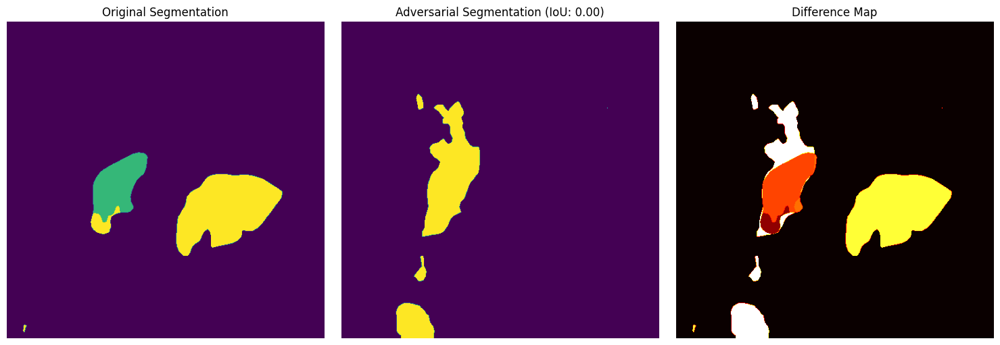

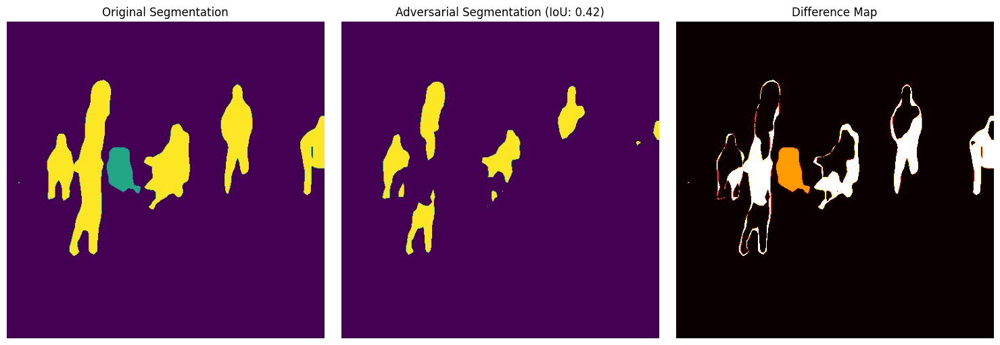

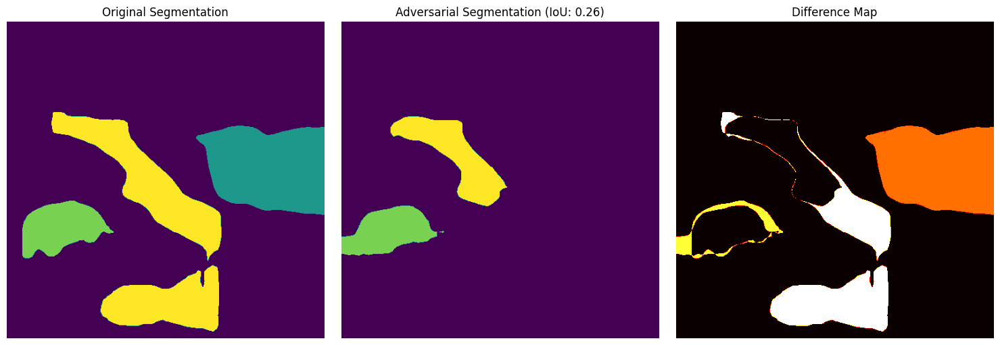

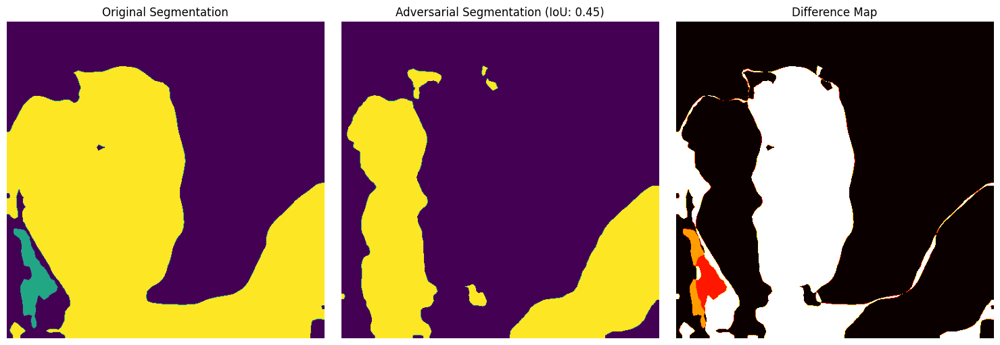

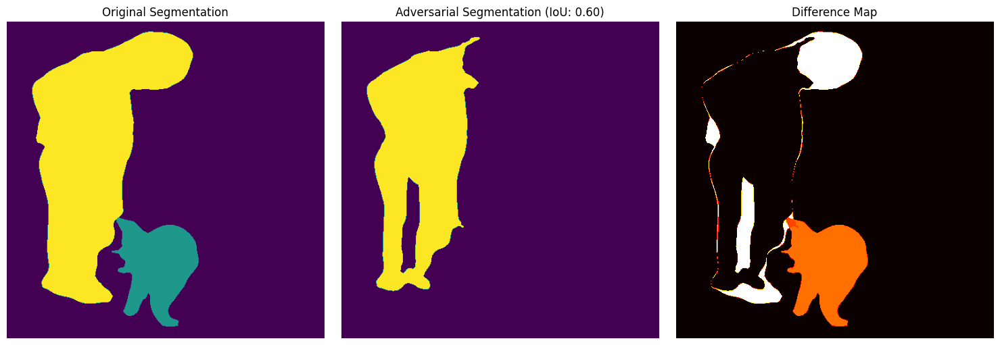

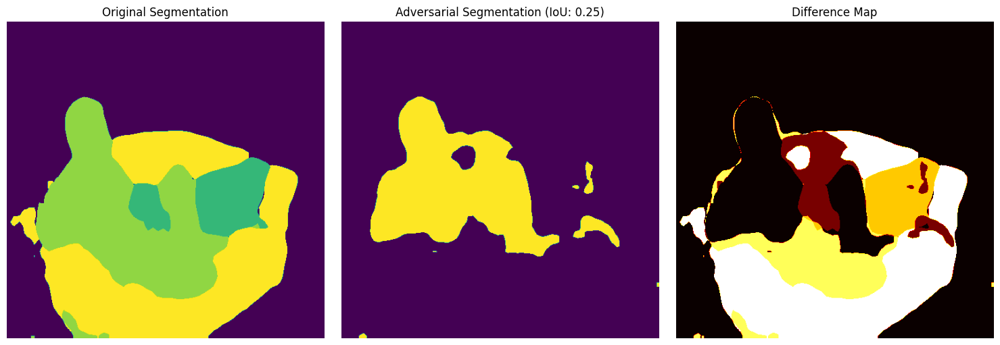

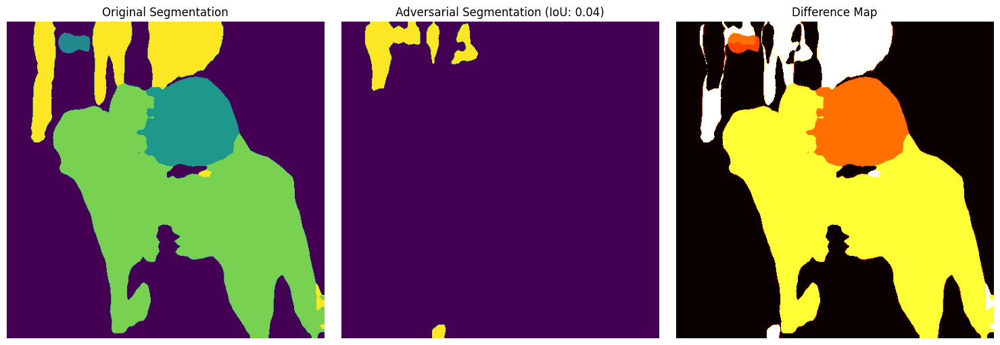

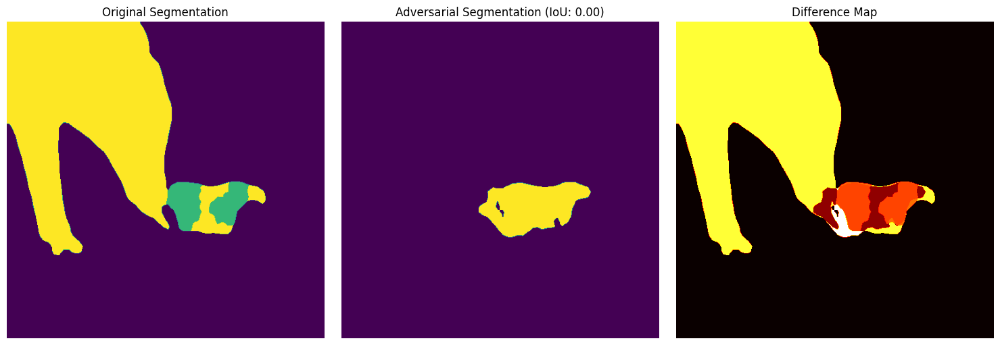

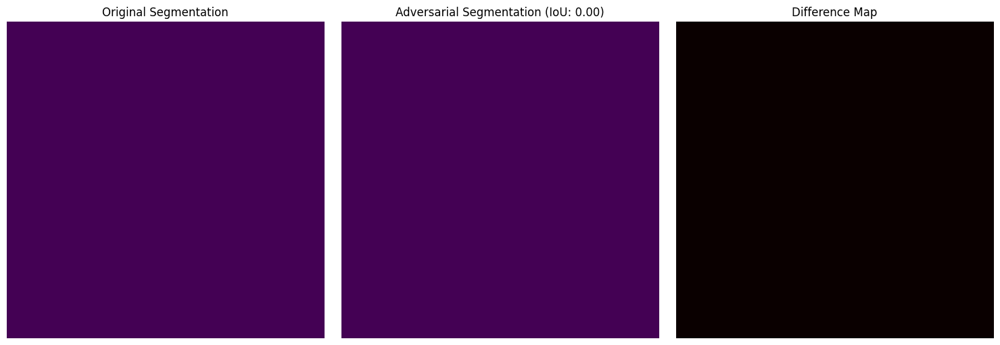

In [18]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.models.segmentation import deeplabv3_resnet50
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Load the pre-trained DeepLabV3 model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = deeplabv3_resnet50(pretrained=True).to(device)
model.eval()

# Define preprocessing
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

transform = transforms.Compose([
    transforms.Resize((512, 512)),  # Resize image
    transforms.ToTensor(),          # Convert to tensor
    transforms.Normalize(mean=mean, std=std)  # Normalize
])

def compute_iou(mask1, mask2):
    """Compute Intersection over Union (IoU) between two segmentation masks."""
    intersection = np.logical_and(mask1 == mask2, mask1 > 0).sum()
    union = np.logical_or(mask1 > 0, mask2 > 0).sum()
    return intersection / union if union > 0 else 0.0

# Process images
for digit in range(9):
    img_path = f"/content/extracted_images/image_{digit}.png"
    image = Image.open(img_path).convert("RGB")
    input_img = transform(image).unsqueeze(0).to(device)  # Add batch dimension

    # Get original segmentation
    with torch.no_grad():
        orig_output = model(input_img)["out"]
        orig_pred = torch.argmax(orig_output, dim=1).cpu().squeeze(0).numpy()

    # Generate a target label (forcing the output to predict "car" everywhere)
    target_class = 1 # faut regarder la base de données MS-COCO pour avoir l'étiquette de chaque classe
    target_label = torch.full((1, 512, 512), target_class, dtype=torch.long).to(device)

    # Define the attack parameters
    epsilon = 0.02  # Maximum perturbation
    alpha = 0.005   # Step size
    num_steps = 10  # Number of iterations

    # Clone image and enable gradients
    adv_img = input_img.clone().detach().requires_grad_(True)
    criterion = nn.CrossEntropyLoss()

    # PGD attack loop
    for i in range(num_steps):
        model.zero_grad()

        # Forward pass
        output = model(adv_img)["out"]

        # Compute loss (encourage misclassification to target class)
        loss = -criterion(output, target_label)  # Targeted attack (minimizing loss)
        loss.backward()

        # Apply perturbation (gradient ascent)
        adv_img.data = adv_img.data - alpha * adv_img.grad.data.sign()

        # Project perturbation to ensure it's within bounds
        perturbation = torch.clamp(adv_img - input_img, -epsilon, epsilon)
        adv_img.data = torch.clamp(input_img + perturbation, 0, 1)  # Ensure valid image range

        # Zero out gradients for next iteration
        adv_img.grad.zero_()

    # Get adversarial segmentation
    with torch.no_grad():
        adv_output = model(adv_img)["out"]
        adv_pred = torch.argmax(adv_output, dim=1).cpu().squeeze(0).numpy()

    # Compute IoU
    iou_score = compute_iou(orig_pred, adv_pred)

    # Compute difference map
    difference_map = np.abs(orig_pred - adv_pred)

    # Visualization (3 columns: Original, Adversarial, Difference Map)
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    ax[0].imshow(orig_pred, cmap="viridis")
    ax[0].set_title("Original Segmentation")
    ax[0].axis("off")

    ax[1].imshow(adv_pred, cmap="viridis")
    ax[1].set_title(f"Adversarial Segmentation (IoU: {iou_score:.2f})")
    ax[1].axis("off")

    ax[2].imshow(difference_map, cmap="hot")
    ax[2].set_title("Difference Map")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()


# Tester la performance du modèle Mask R-CNN:
Mask R-CNN est un modèle de segmentation d’instances qui détecte des objets dans une image et génère un masque pour chaque objet identifié. Il est basé sur Faster R-CNN, un modèle de détection d’objets, auquel il ajoute une branche supplémentaire pour la segmentation.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth
100%|██████████| 170M/170M [00:01<00:00, 157MB/s]


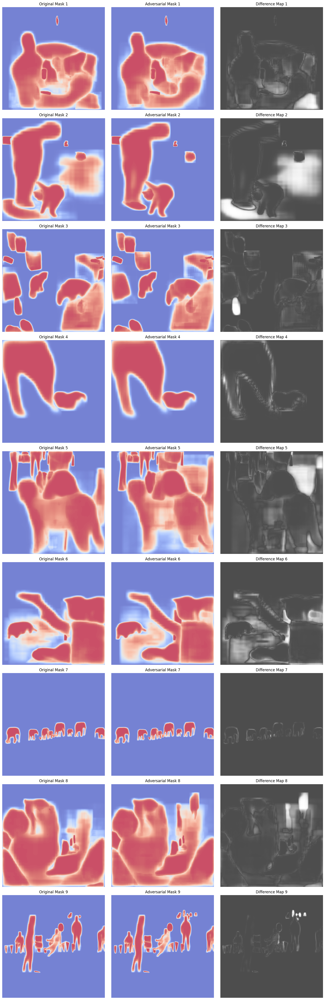

In [20]:
import torch
import torchvision
import matplotlib.pyplot as plt
import numpy as np
from torchvision.transforms import functional as F
from PIL import Image

# Load Mask R-CNN Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True).to(device)
model.eval()

def preprocess_image(img_path):
    """Load and preprocess an image."""
    img = Image.open(img_path).convert("RGB")
    img_tensor = F.to_tensor(img).unsqueeze(0)  # Convert to tensor
    return img, img_tensor.to(device)

def extract_masks(model, image_tensor):
    """Run Mask R-CNN and extract segmentation masks."""
    with torch.no_grad():
        output = model(image_tensor.squeeze(0))

    masks = output[0]['masks'].squeeze(1).cpu().numpy()  # Extract masks & move to CPU
    combined_mask = np.zeros_like(masks[0])  # Initialize blank mask

    # Merge all masks into one
    for mask in masks:
        combined_mask = np.maximum(combined_mask, mask)

    return combined_mask

def show_mask_rcnn_results(input_tensors, adv_images, num):
    """Display original segmentation, adversarial segmentation & difference map."""

    fig, axs = plt.subplots(num, 3, figsize=(15, 5 * num))

    for i in range(num):
        # Load Images
        original_tensor = input_tensors[i].to(device)
        adv_tensor = adv_images[i].to(device)

        # Get Mask R-CNN Segmentations
        original_mask = extract_masks(model, original_tensor.unsqueeze(0))
        adv_mask = extract_masks(model, adv_tensor.unsqueeze(0))

        # Compute Difference Map
        diff_mask = np.abs(original_mask - adv_mask)

        # Plot Results
        axs[i, 0].imshow(original_mask, cmap="coolwarm", alpha=0.7)
        axs[i, 0].set_title(f"Original Mask {i+1}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(adv_mask, cmap="coolwarm", alpha=0.7)
        axs[i, 1].set_title(f"Adversarial Mask {i+1}")
        axs[i, 1].axis("off")

        axs[i, 2].imshow(diff_mask, cmap="gray", alpha=0.7)
        axs[i, 2].set_title(f"Difference Map {i+1}")
        axs[i, 2].axis("off")

        # Free GPU memory
        del original_tensor, adv_tensor
        torch.cuda.empty_cache()

    plt.tight_layout()
    plt.show()

# Example usage:
show_mask_rcnn_results(input_tensors, adv_images, num)


# Pour afficher les images originales et attaquées sans segmentation avec les images segmentées correspondantes:


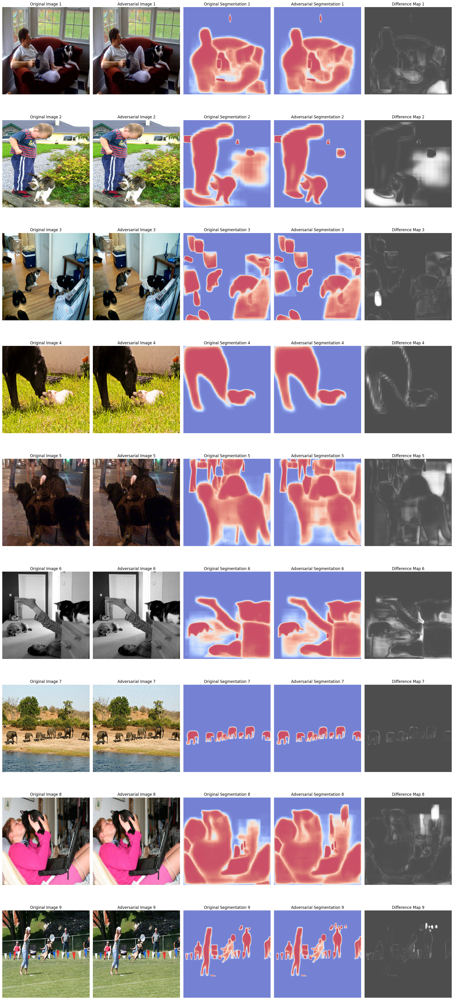

In [24]:
import torch
import torchvision
import matplotlib.pyplot as plt
import numpy as np
from torchvision.transforms import functional as F
from PIL import Image

# Load Mask R-CNN Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True).to(device)
model.eval()

def extract_masks(model, image_tensor):
    """Run Mask R-CNN and extract segmentation masks."""
    with torch.no_grad():
        output = model(image_tensor)  # Ensure batch dimension

    masks = output[0]['masks'].squeeze(1).cpu().numpy()  # Extract masks & move to CPU
    combined_mask = np.zeros_like(masks[0])  # Initialize blank mask

    # Merge all masks into one
    for mask in masks:
        combined_mask = np.maximum(combined_mask, mask)

    return combined_mask

def show_mask_rcnn_results(input_tensors, adv_images, num):
    """Display original/adversarial images, segmentations & difference maps."""

    fig, axs = plt.subplots(num, 5, figsize=(20, 5 * num))  # 5 columns: original, adv, seg1, seg2, diff

    for i in range(num):
        # Convert tensors to PIL images for visualization
        original_pil = F.to_pil_image(input_tensors[i].cpu().squeeze(0))
        adv_pil = F.to_pil_image(adv_images[i].cpu().squeeze(0))

        original_tensor = input_tensors[i].to(device)
        adv_tensor = adv_images[i].to(device)

        # Get Mask R-CNN Segmentations
        original_mask = extract_masks(model, original_tensor)
        adv_mask = extract_masks(model, adv_tensor)

        # Compute Difference Map
        diff_mask = np.abs(original_mask - adv_mask)

        # Plot Results
        axs[i, 0].imshow(original_pil)
        axs[i, 0].set_title(f"Original Image {i+1}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(adv_pil)
        axs[i, 1].set_title(f"Adversarial Image {i+1}")
        axs[i, 1].axis("off")

        axs[i, 2].imshow(original_mask, cmap="coolwarm", alpha=0.7)
        axs[i, 2].set_title(f"Original Segmentation {i+1}")
        axs[i, 2].axis("off")

        axs[i, 3].imshow(adv_mask, cmap="coolwarm", alpha=0.7)
        axs[i, 3].set_title(f"Adversarial Segmentation {i+1}")
        axs[i, 3].axis("off")

        axs[i, 4].imshow(diff_mask, cmap="gray", alpha=0.7)
        axs[i, 4].set_title(f"Difference Map {i+1}")
        axs[i, 4].axis("off")

        # Free GPU memory
        del original_tensor, adv_tensor
        torch.cuda.empty_cache()

    plt.tight_layout()
    plt.show()

# Example usage:
show_mask_rcnn_results(input_tensors, adv_images, num)


# Tester la performance du modèle DeiT:
DeiT (Data-efficient Image Transformer) est un modèle de vision basé sur les Transformers, introduit par Facebook AI. Il est conçu pour la classification d’images et optimise l’entraînement des Vision Transformers (ViTs) avec moins de données et sans besoin d’un grand dataset spécifique comme JFT-300M (contrairement aux ViTs de Google).

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/271 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/utils/deprecation.py:165: UserWarning: The following named arguments are not valid for `SegformerFeatureExtractor.__init__` and were ignored: 'feature_extractor_type'
  return func(*args, **kwargs)


config.json:   0%|          | 0.00/6.88k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/110M [00:00<?, ?B/s]

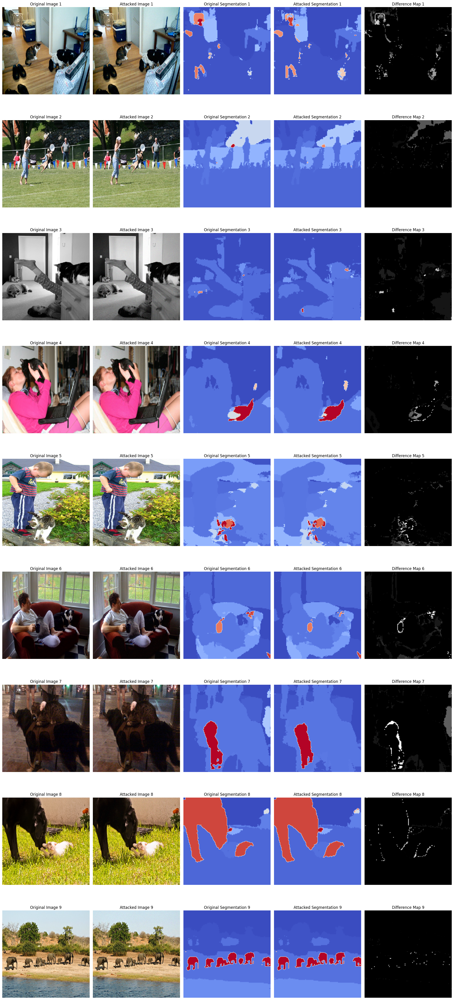

In [25]:
import torch
import timm
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision.models.segmentation import deeplabv3_resnet50
from transformers import AutoFeatureExtractor, AutoModelForSemanticSegmentation
from PIL import Image

# Load DeiT model (feature extractor)
deit_model = timm.create_model("deit_base_patch16_224", pretrained=True, num_classes=0)

# Modify DeepLabV3 to use DeiT features
class DeiTDeepLabV3(nn.Module):
    def __init__(self):
        super(DeiTDeepLabV3, self).__init__()
        self.backbone = deit_model
        self.segmentation_head = deeplabv3_resnet50(pretrained=True)

        # Replace DeepLabV3 backbone with DeiT
        self.segmentation_head.backbone = nn.Sequential(*list(self.backbone.children())[:-1])

    def forward(self, x):
        return self.segmentation_head(x)

# Load segmentation model (SETR)
model_name = "nvidia/segformer-b2-finetuned-ade-512-512"
feature_extractor = AutoFeatureExtractor.from_pretrained(model_name)
segmentation_model = AutoModelForSemanticSegmentation.from_pretrained(model_name)
segmentation_model.eval()

# Function to preprocess image
def preprocess_image(img_path):
    image = Image.open(img_path).convert("RGB")
    inputs = feature_extractor(images=image, return_tensors="pt")
    return image, inputs

# Function to extract segmentation
def get_segmentation_map(model, inputs):
    with torch.no_grad():
        outputs = model(**inputs)
    return outputs.logits.argmax(dim=1).squeeze().cpu().numpy()

# Function to generate adversarial attack (mock example)
def adversarial_attack(image):
    """ Simulated attack: Add small perturbations to the image """
    adv_image = np.array(image) / 255.0
    perturbation = np.random.uniform(-0.05, 0.05, adv_image.shape)  # Random noise
    adv_image = np.clip(adv_image + perturbation, 0, 1)  # Clip to valid range
    return Image.fromarray((adv_image * 255).astype(np.uint8))

# Load & process 9 images
num_images = 9
img_paths = [f"/content/extracted_images/image_{i}.png" for i in range(num_images)]

original_images = []
attacked_images = []
original_segmentations = []
attacked_segmentations = []

for img_path in img_paths:
    orig_img, inputs = preprocess_image(img_path)
    original_images.append(orig_img)

    # Generate adversarial attack
    adv_img = adversarial_attack(orig_img)
    attacked_images.append(adv_img)

    # Get segmentation maps
    orig_seg = get_segmentation_map(segmentation_model, inputs)
    attacked_inputs = feature_extractor(images=adv_img, return_tensors="pt")
    adv_seg = get_segmentation_map(segmentation_model, attacked_inputs)

    original_segmentations.append(orig_seg)
    attacked_segmentations.append(adv_seg)

# Plot 9 images in a 9x5 grid
fig, axs = plt.subplots(num_images, 5, figsize=(20, 5 * num_images))

for i in range(num_images):
    # Compute difference map
    diff_map = np.abs(original_segmentations[i] - attacked_segmentations[i])

    # Display results
    axs[i, 0].imshow(original_images[i])
    axs[i, 0].set_title(f"Original Image {i+1}")
    axs[i, 0].axis("off")

    axs[i, 1].imshow(attacked_images[i])
    axs[i, 1].set_title(f"Attacked Image {i+1}")
    axs[i, 1].axis("off")

    axs[i, 2].imshow(original_segmentations[i], cmap="coolwarm")
    axs[i, 2].set_title(f"Original Segmentation {i+1}")
    axs[i, 2].axis("off")

    axs[i, 3].imshow(attacked_segmentations[i], cmap="coolwarm")
    axs[i, 3].set_title(f"Attacked Segmentation {i+1}")
    axs[i, 3].axis("off")

    axs[i, 4].imshow(diff_map, cmap="gray")
    axs[i, 4].set_title(f"Difference Map {i+1}")
    axs[i, 4].axis("off")

plt.tight_layout()
plt.show()


# **Conclusion :**  
Dans le cadre de notre projet d’attaque adversariale en segmentation, **DeiT**, **DeepLabV3** et **Mask R-CNN** réagissent différemment aux attaques comme **FGSM** et **PGD**. Grâce à son mécanisme d’**attention globale**, DeiT peut offrir une certaine résistance par rapport aux **CNN classiques**, mais reste vulnérable face à des perturbations plus fortes ou des attaques itératives comme PGD. **DeepLabV3**, basé sur **ResNet**, et **Mask R-CNN**, combinant détection et segmentation, sont généralement plus sensibles aux attaques adversariale. Une approche clé pour améliorer la robustesse de ces modèles consiste à utiliser **l'entraînement adversarial**, qui leur permet de mieux s’adapter aux perturbations en les exposant à des exemples adversariaux durant l’apprentissage.